Subclustering for the leiden cluster on uMAP containing Fibroblasts
<br>

# Packages

In [2]:
import os
import anndata
import logging
import numpy as np
import pandas as pd
from datetime import timedelta, datetime
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import leidenalg
import csv
from pandas import Timestamp
import re
import matplotlib.pyplot as plt
from scipy.stats import rankdata 
import scipy
import harmonypy as hm
import random
from scipy.stats.stats import pearsonr   
import scipy.sparse
from SCCAF import *

In [ ]:
sc.settings.verbosity =3
sc.logging.print_version_and_date()
sc.settings.set_figure_params(dpi=140, color_map='RdBu_r')

In [4]:
random_state=10
date="20200921"
path_to_fast="/fast/AG_Huebner/"
path_out=path_to_fast+"huebner3/ANALYSES/20190926_gp_BadOyenhausen/scanpy/20210302/Subclusters/"
path_in=path_to_fast+"huebner3/ANALYSES/20190926_gp_BadOyenhausen/scanpy/20210302/FB/"

In [27]:
%load_ext rpy2.ipython

# Functions

In [9]:
def plot_celltype_abundance(adata_obs, Region, variable='leiden_annotated', 
                            normalised_by=None, 
                            Genes_column='Gene',
                            Genes_to_plot=['PKP2', 'LMNA', 'PLN', 'RBM20', 'TTN', 'DES', 'control', 'mutation negative'], 
                            celltypes_to_plot=['CM', 'FB', 'MP', 'EC'], plottype="boxplot", 
                            show_points=True, return_table=False, save_png=None, ylimit=None):
    # Example how to use this function=
    # plot_celltype_abundance(adata_obs, 'AP', 'global_annotated'), where adata_obs=adata.obs
    
    count=0 # This is needed in case one genotype is not found
    
    # Subsetting for region
    if Region == "LV":
        tmp=adata_obs[adata_obs['Region'].isin(['FW', 'AP'])]
    
    elif Region == "LVS":
        tmp=adata_obs[adata_obs['Region'].isin(['FW', 'AP', 'S'])]
    
    elif Region == "all":
        tmp=adata_obs
    else:
        tmp=adata_obs[adata_obs['Region'].isin([Region])]
    
    # Calculates percentage per gene
    for gene_nr in range(len(Genes_to_plot)):
    #gene_nr=0
        Gene=Genes_to_plot[gene_nr]
        tmp_=tmp[tmp[Genes_column].isin([Gene])]
        ax= pd.crosstab(tmp_['Patient'], 
                        tmp_[variable]).apply(lambda r: r/r.sum()*100, axis=1).copy()
        if ax.shape[0]==0:
            continue
        if celltypes_to_plot is not None:
            ax=ax[celltypes_to_plot]#, 'FB', 'EC', 'MP', 'PC']]
            celltypes_to_plot=celltypes_to_plot[0:]
        if normalised_by is not None:
            normalize=ax[normalised_by]
            ax=ax.apply(lambda r: r/normalize, axis=0)
            y_axis_title="% celltype / "+ normalised_by
        else:
            y_axis_title="% celltype"
            
        index_ax = ax.index.to_frame(index=False) 
        ax = ax.reset_index(drop=True) 
        ax = pd.merge(index_ax, ax, left_index=True, right_index=True) 
        ax_melt=pd.melt(ax, id_vars='Patient')
        ax_melt[Genes_column]=Gene + " (n=" + str(ax.shape[0]) + ")"
        if ax.shape[0] != 0: 
            if count==0:
                final_df = ax_melt
                count=+1
            else:
                final_df=pd.concat([final_df, ax_melt], axis=0)
                
    # If you want to have a table only
    if return_table == True:
        return final_df
    
    # If you want to have a plot only
    else:
        %matplotlib inline
        plt.figure(figsize=[14,10], dpi=200, facecolor='w', edgecolor='k')
        if plottype == "boxplot":
            sns.set_style(style='white')
            flierprops = dict(markerfacecolor='0.75', markersize=3,
                          linestyle='none')
            if show_points is True:
                ax=sns.swarmplot(x="variable", y="value", hue=Genes_column, data=final_df, color=".25", dodge=True, size=3)
            ax=sns.boxplot(x="variable", y='value', hue=Genes_column, data=final_df, flierprops=flierprops, showfliers = False)
            handles, labels = ax.get_legend_handles_labels()
            plt.legend(handles[0:len(set(final_df[Genes_column]))], labels[0:len(set(final_df[Genes_column]))], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize='x-large')
            ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
            ax.set_ylabel(y_axis_title,fontsize=40)
            ax.set_xlabel("Cell type",fontsize=40)
            ax.tick_params(labelsize=30)
            if ylimit is not None:
                ax.set(ylim=(0, ylimit))
        elif plottype == "violinplot":           
            if show_points == True:
                ax = sns.violinplot(x="variable", y="value", hue=Genes_column, data=final_df, inner="points")
            else:
                ax = sns.violinplot(x="variable", y="value", hue=Genes_column, data=final_df) 
            handles, labels = ax.get_legend_handles_labels()
            ax.set_xticklabels(ax.get_xticklabels(), rotation=0)
            plt.legend(handles[0:len(set(final_df[Genes_column]))], labels[0:len(set(final_df[Genes_column]))], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize='x-large')
            ax.set_ylabel(y_axis_title,fontsize=40)
            ax.set_xlabel("Cell type",fontsize=40)
            ax.tick_params(labelsize=30)
            ax
    
    # If you want to save the figure
    if save_png != None:
        plt.savefig(save_png, transparent=True)

In [10]:
def intersection(lst1, lst2): 
    return list(set(lst1) & set(lst2)) 

In [13]:
def prep_adata_forcellxgene(adata):
    adata=anndata.AnnData(X=adata.raw.X, 
                                         obs=adata.obs, 
                                         var=adata.raw.var, 
                                         uns=adata.uns, 
                                         obsm=adata.obsm)
    adata.obs=adata.obs[['Sample', 'Center', 'Patient', 'Gender', 'Region', 'Diagnosis', 'Gene', 'Age', 'ACMG.score', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'predicted_doublets_default', 'predicted_doublets_log', 'predicted_doublets_solo', 'leiden_annotated']]
    return adata
    #adata.write(path_out + "FB_ALL_LEIDEN_CELLXGENE2.h5ad")

In [14]:
def correlation_analysis(scanpy_object, column_tosplitby, sum_or_mean):
    d = {}
    for cluster_number in np.unique(scanpy_object.obs[column_tosplitby].values):
        #cluster_number=np.unique(heart.obs['louvain_annotated'].values)[1]
        scanpy_object_subset = scanpy_object[scanpy_object.obs[column_tosplitby].isin([cluster_number])]

        if sum_or_mean=="mean":
            d[cluster_number] = np.squeeze(np.asarray(scanpy_object_subset.raw.X.mean(axis=0))) #np.log(+1)
        elif sum_or_mean=="sum":
            d[cluster_number] = np.squeeze(np.asarray(scanpy_object_subset.raw.X.sum(axis=0))) #np.log(+1)
        del scanpy_object_subset
        
    return d

# Data

Load raw data for subclustering

In [29]:
FB_all_all=sc.read_h5ad(path_in + "FB_20210305_V1_RAW.h5ad")

In [30]:
FB_all_all.obs

,Patient,Sample,Gender,Gene,Diagnosis,Clinical.dominant.mutation,Age,Mutation.Type,Genomic.location,Region,...,cell_type_fine_20200921,cell_states_20200921,cell_states_long_20200921,cell_states_20210218,validated_20210218,leiden_01,leiden_02,leiden_03,leiden_04,cell_type
Barcode,,,,,,,,,,,,,,,,,,,,,
AAACCCATCGTTCCCA-BS_DP2_RV_premrna,DP2,BS_DP2_RV0_premrna,f,PLN,DCM,PLN,44.0,Missense,chr6:+:118558946,RV,...,FB,vFB1.0,vFB1.0_Canonical,vFB1.0,TRUE,2,2,2,2,FB
AAAGGATCATACTTTC-BS_DP2_RV_premrna,DP2,BS_DP2_RV0_premrna,f,PLN,DCM,PLN,44.0,Missense,chr6:+:118558946,RV,...,FB,vFB2,vFB2_ECM_p,vFB2,TRUE,2,2,2,2,FB
AAAGGGCTCGTAGGAG-BS_DP2_RV_premrna,DP2,BS_DP2_RV0_premrna,f,PLN,DCM,PLN,44.0,Missense,chr6:+:118558946,RV,...,FB,vFB2,vFB2_ECM_p,vFB2,TRUE,2,2,2,2,FB
AAAGTCCTCCTAGCTC-BS_DP2_RV_premrna,DP2,BS_DP2_RV0_premrna,f,PLN,DCM,PLN,44.0,Missense,chr6:+:118558946,RV,...,FB,vFB1.0,vFB1.0_Canonical,vFB2,TRUE,2,2,2,2,FB
AACAACCCATGAATAG-BS_DP2_RV_premrna,DP2,BS_DP2_RV0_premrna,f,PLN,DCM,PLN,44.0,Missense,chr6:+:118558946,RV,...,FB,vFB1.0,vFB1.0_Canonical,vFB1.0,TRUE,2,2,2,2,FB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGATCTCATGGGAG-IC_H04_RV0_premrna,IC_H04,IC_H04_RV0_premrna,f,mutation negative,DCM,mutation negative,63.0,nan,nan,RV,...,nan,nan,nan,nan,nan,2,2,2,2,FB
TTTGGAGCACGCAAAG-IC_H04_RV0_premrna,IC_H04,IC_H04_RV0_premrna,f,mutation negative,DCM,mutation negative,63.0,nan,nan,RV,...,nan,nan,nan,nan,nan,2,2,2,2,FB
TTTGGAGTCCATCAGA-IC_H04_RV0_premrna,IC_H04,IC_H04_RV0_premrna,f,mutation negative,DCM,mutation negative,63.0,nan,nan,RV,...,nan,nan,nan,nan,nan,2,2,2,2,FB


# Analysis

## With all nuclei 

In [31]:
FB_all_all.shape

(155714, 33538)

In [32]:
FB_all_all.obs.n_genes.describe()

count    155714.000000
mean       1472.987779
std         735.819805
min         300.000000
25%         989.000000
50%        1357.000000
75%        1775.000000
max        5000.000000
Name: n_genes, dtype: float64

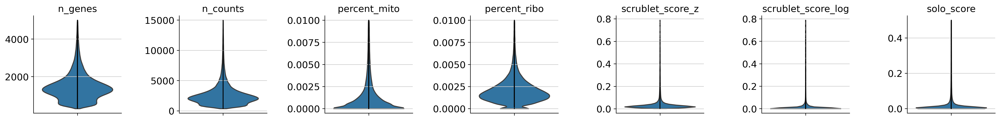

In [33]:
sc.pl.violin(FB_all_all, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo', "scrublet_score_z", 'scrublet_score_log', "solo_score"],
             jitter=0.001, multi_panel=True) 

In [34]:
sc.pp.normalize_per_cell(FB_all_all, counts_per_cell_after=1e4)
sc.pp.log1p(FB_all_all)
FB_all_all.raw=FB_all_all

normalizing by total count per cell
    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


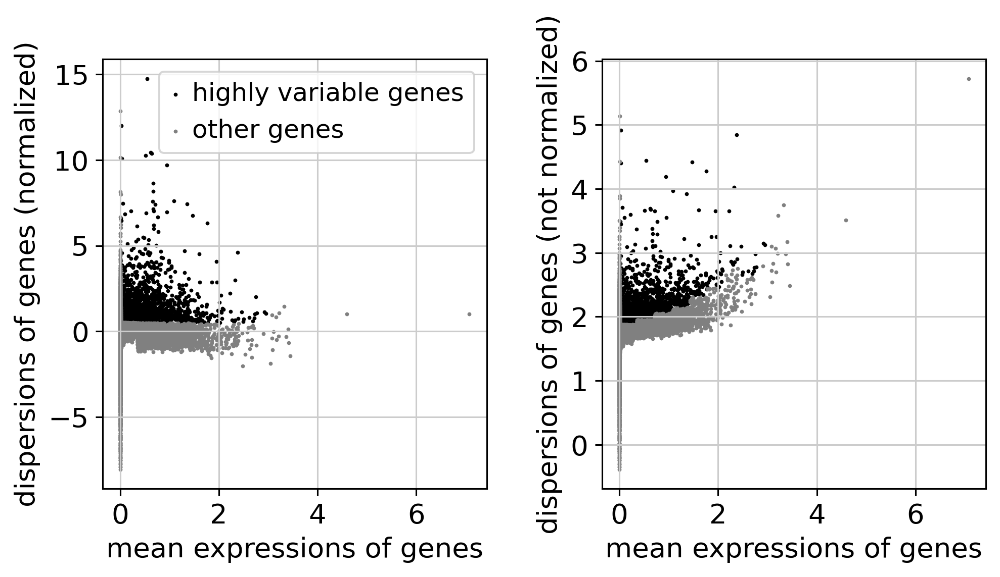

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:11:14)


(155714, 3327)

In [35]:
sc.pp.highly_variable_genes(FB_all_all)
sc.pl.highly_variable_genes(FB_all_all)
FB_all_all_hvg = FB_all_all[:, FB_all_all.var['highly_variable']]
sc.pp.regress_out(FB_all_all_hvg, ['n_counts', 'percent_mito'])
sc.pp.scale(FB_all_all_hvg, max_value = 10)
FB_all_all_hvg.shape

In [36]:
sc.tl.pca(FB_all_all_hvg, svd_solver = 'arpack', random_state = random_state)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:23)


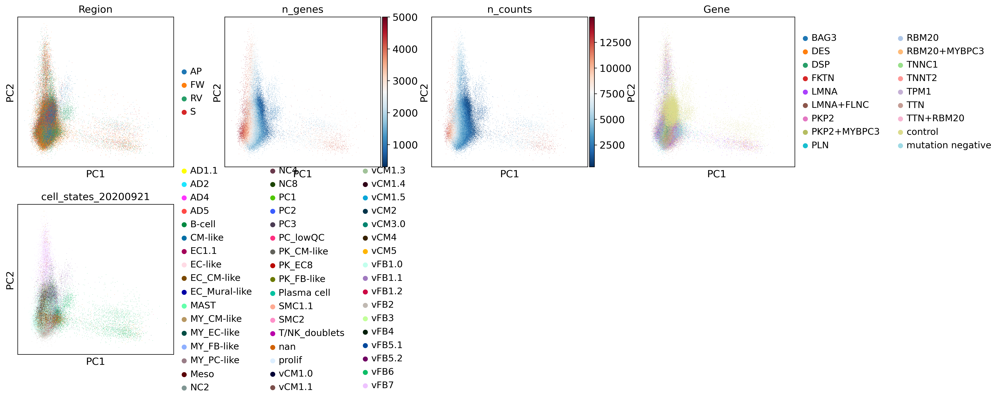

In [37]:
sc.pl.pca(FB_all_all_hvg, color = ['Region', 'n_genes', 'n_counts', 'Gene', 'cell_states_20200921'])

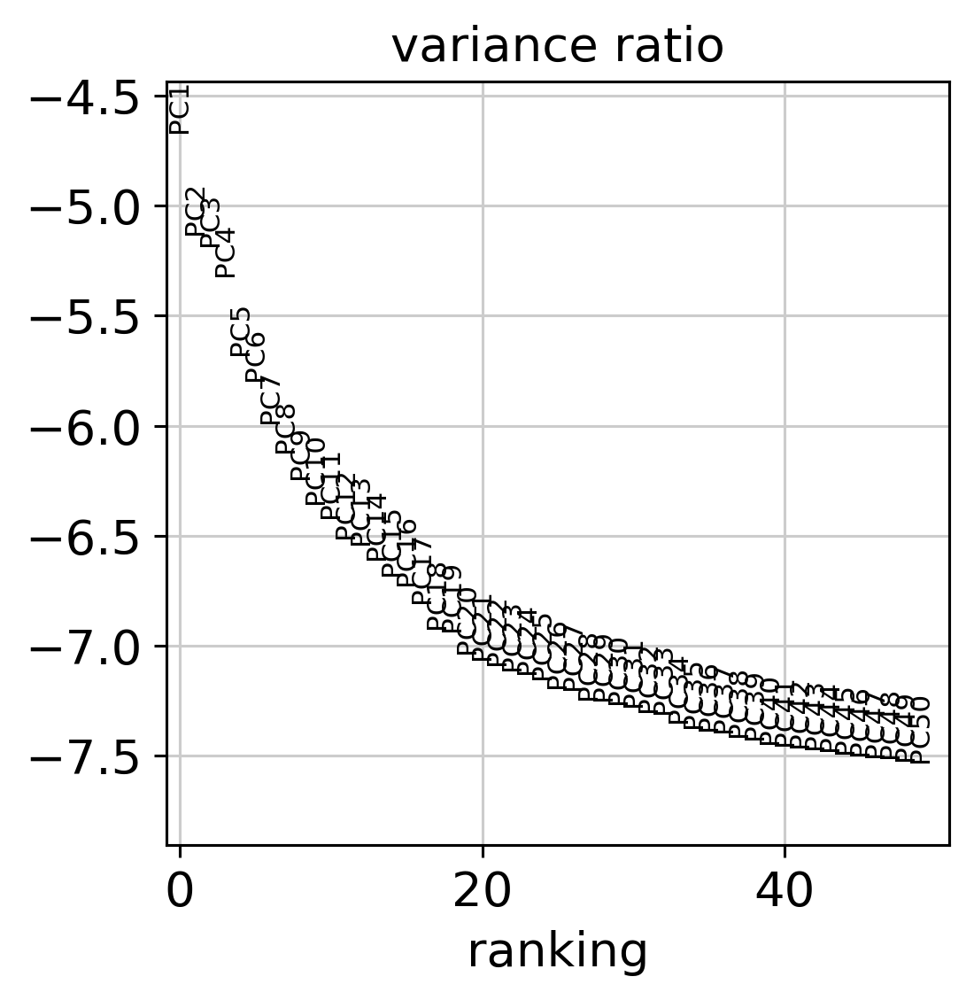

In [38]:
sc.pl.pca_variance_ratio(FB_all_all_hvg, log=True, n_pcs=50)

In [39]:
num_pcs= 17 # 40 no
pca = FB_all_all_hvg.obsm['X_pca']
meta_data = FB_all_all_hvg.obs
FB_all_harmony=FB_all_all_hvg.copy()

In [40]:
ho = hm.run_harmony(pca, meta_data, ['Patient'], 
                    epsilon_harmony = -float('Inf'), epsilon_cluster = -float('Inf'), 
                    random_state=random_state)

2021-03-06 11:26:09,724 - harmonypy - INFO - Iteration 1 of 10
2021-03-06 11:27:47,937 - harmonypy - INFO - Iteration 2 of 10
2021-03-06 11:29:27,446 - harmonypy - INFO - Iteration 3 of 10
2021-03-06 11:30:59,023 - harmonypy - INFO - Iteration 4 of 10
2021-03-06 11:32:04,481 - harmonypy - INFO - Iteration 5 of 10
2021-03-06 11:33:15,194 - harmonypy - INFO - Iteration 6 of 10
2021-03-06 11:34:22,208 - harmonypy - INFO - Iteration 7 of 10
2021-03-06 11:35:27,072 - harmonypy - INFO - Iteration 8 of 10
2021-03-06 11:36:29,965 - harmonypy - INFO - Iteration 9 of 10
2021-03-06 11:37:34,906 - harmonypy - INFO - Iteration 10 of 10
2021-03-06 11:38:39,869 - harmonypy - INFO - Stopped before convergence


In [41]:
res = pd.DataFrame(ho.Z_corr)
res=res.T

In [42]:
FB_all_harmony.obsm['X_pca'] = res.values
sc.pp.neighbors(FB_all_harmony, n_pcs=num_pcs, random_state=random_state, n_neighbors= 15)

computing neighbors
    using 'X_pca' with n_pcs = 17


/fast/AG_Huebner/GUIX_PROFILES/conda_envs/scanpy_151/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:355: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 6103. The TBB threading layer is disabled.
  warnings.warn(problem)


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:50)


In [43]:
sc.tl.umap(FB_all_harmony, random_state = random_state, min_dist = 0.1, spread = 1, n_components=2)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:45)


In [44]:
sc.tl.leiden(FB_all_harmony, resolution = 0.7, random_state = random_state)

running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:03:48)


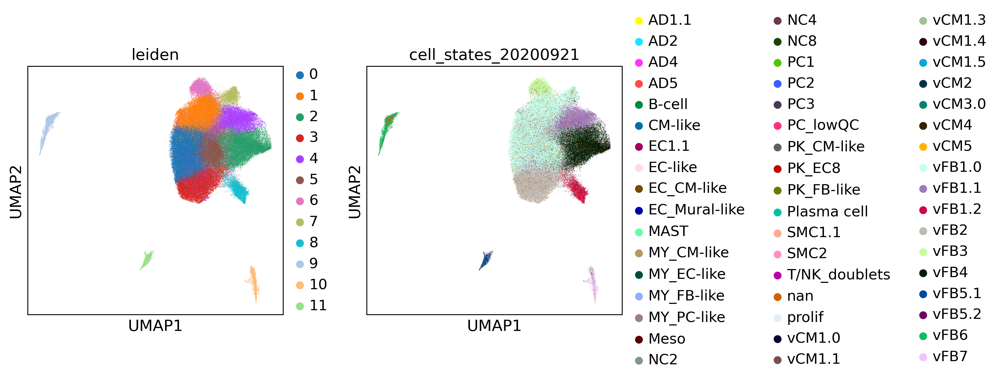

In [45]:
sc.pl.umap(FB_all_harmony,#[FB_all_harmony.obs.Gene.isin(['control'])], 
           color=['leiden', 'cell_states_20200921'], 
           projection='2d', components=['1,2'])

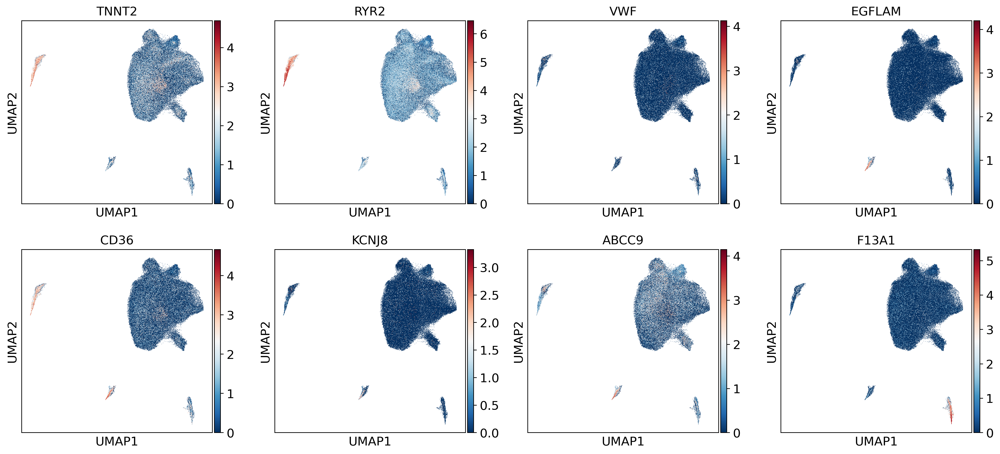

In [48]:
sc.pl.umap(FB_all_harmony,#[FB_all_harmony.obs.Gene.isin(['control'])], 
           color=['TNNT2', 'RYR2',
                  'VWF', 'EGFLAM', 'CD36', 'KCNJ8', 'ABCC9',
                 'F13A1'], 
           projection='2d', components=['1,2'])

Cluster 9, 10 and 11 are most likely chimeric states, as they show high overlap with canonical CM, Pericyte and myeloid markers. To obatin a finer annotation for the remaining clusters, we remove them and recluster them again, see section below. 

In [163]:
#FB_all_harmony.write(path_in + "/FB_wdoublets_LEIDEN.h5ad")
#FB_all_harmony.obs.to_csv(path_in + "/FB_wdoublets_LEIDEN_OBS.csv")

## Remove nuclei with background/unfiltered doublets 

The FB_all_all object contains raw UMI counts

In [49]:
FB_all_all_nobackground=FB_all_all[~FB_all_harmony.obs.leiden.isin(['9', '10', '11'])].copy()

extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


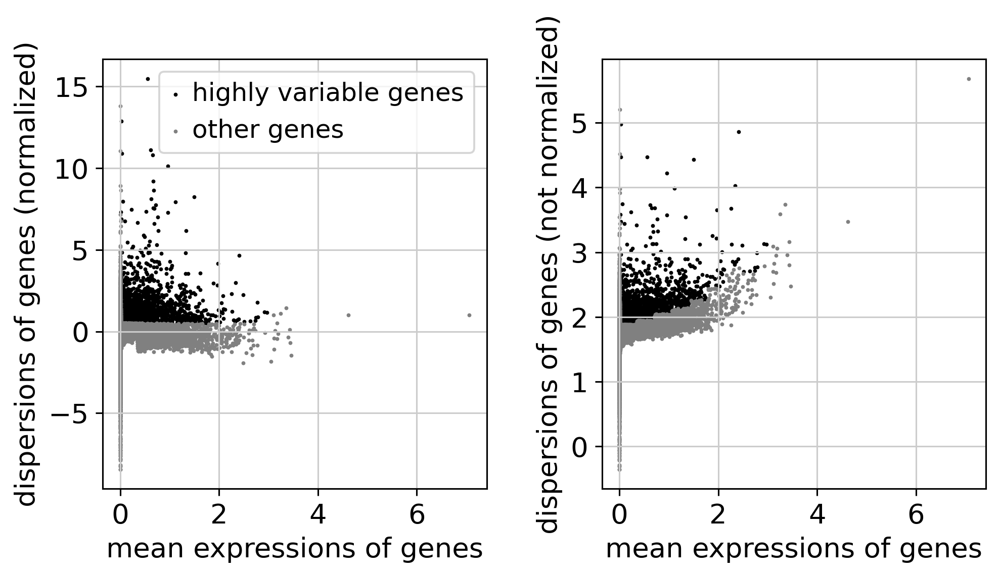

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:06:46)


(142816, 3373)

In [50]:
sc.pp.highly_variable_genes(FB_all_all_nobackground)
sc.pl.highly_variable_genes(FB_all_all_nobackground)
FB_all_all_nobackground_hvg = FB_all_all_nobackground[:, FB_all_all_nobackground.var['highly_variable']]
sc.pp.regress_out(FB_all_all_nobackground_hvg, ['n_counts', 'percent_mito'])
sc.pp.scale(FB_all_all_nobackground_hvg, max_value = 10)
FB_all_all_nobackground_hvg.shape

In [51]:
sc.tl.pca(FB_all_all_nobackground_hvg, svd_solver = 'arpack', random_state = random_state)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:19)


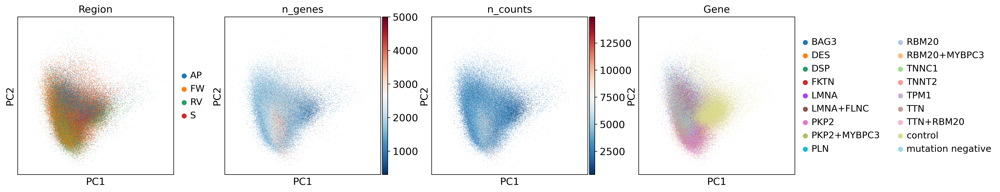

In [53]:
sc.pl.pca(FB_all_all_nobackground_hvg, color = ['Region', 'n_genes', 'n_counts', 'Gene'])

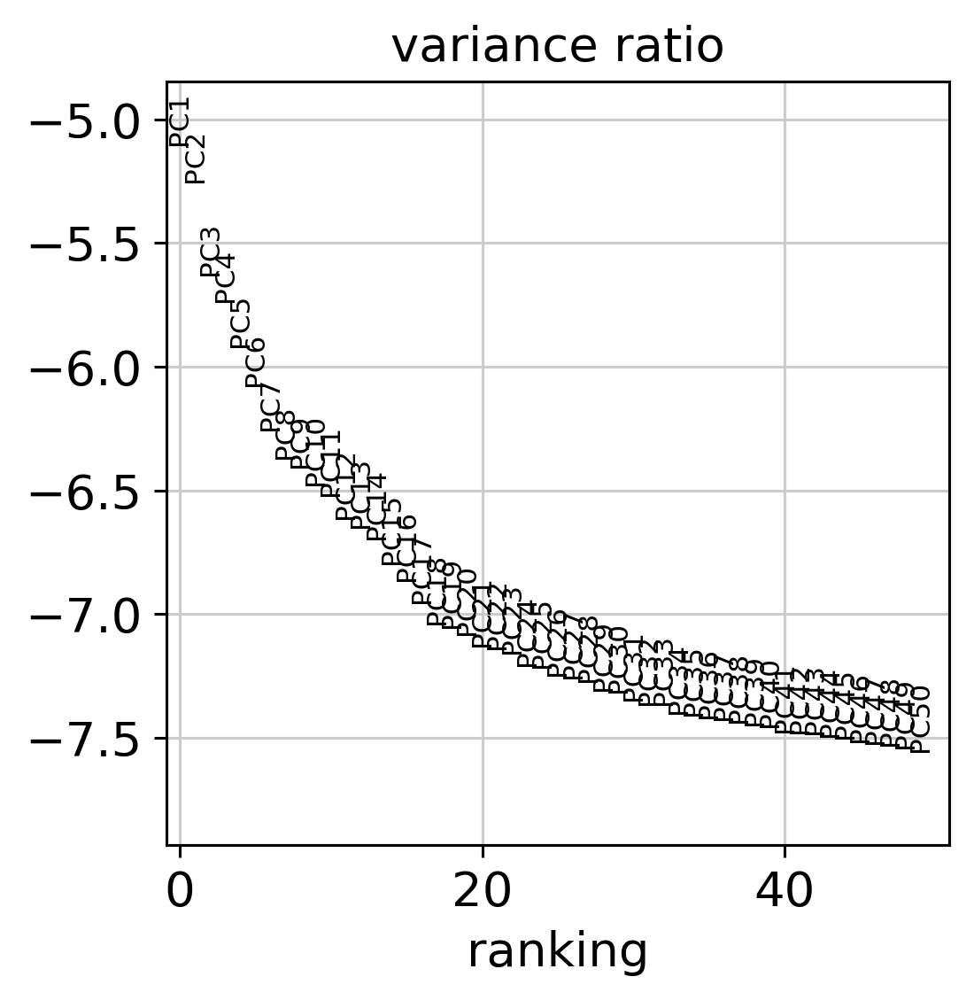

In [54]:
sc.pl.pca_variance_ratio(FB_all_all_nobackground_hvg, log=True, n_pcs=50)

In [55]:
FB_all_all_nobackground_hvg.uns["pca"]['variance'][:12].sum()

94.01261991037356

In [56]:
num_pcs= 12 # 40 no
pca = FB_all_all_nobackground_hvg.obsm['X_pca']
meta_data = FB_all_all_nobackground_hvg.obs
FB_all_nobackground_harmony=FB_all_all_nobackground_hvg.copy()

In [57]:
ho = hm.run_harmony(pca, meta_data, ['Patient'], 
                    epsilon_harmony = -float('Inf'), epsilon_cluster = -float('Inf'), 
                    random_state=random_state)

2021-03-06 13:53:09,664 - harmonypy - INFO - Iteration 1 of 10
2021-03-06 13:54:10,917 - harmonypy - INFO - Iteration 2 of 10
2021-03-06 13:55:12,544 - harmonypy - INFO - Iteration 3 of 10
2021-03-06 13:56:16,185 - harmonypy - INFO - Iteration 4 of 10
2021-03-06 13:57:17,875 - harmonypy - INFO - Iteration 5 of 10
2021-03-06 13:58:17,905 - harmonypy - INFO - Iteration 6 of 10
2021-03-06 13:59:17,170 - harmonypy - INFO - Iteration 7 of 10
2021-03-06 14:00:20,411 - harmonypy - INFO - Iteration 8 of 10
2021-03-06 14:01:32,614 - harmonypy - INFO - Iteration 9 of 10
2021-03-06 14:03:21,148 - harmonypy - INFO - Iteration 10 of 10
2021-03-06 14:05:26,930 - harmonypy - INFO - Stopped before convergence


In [58]:
res = pd.DataFrame(ho.Z_corr)
res=res.T

In [59]:
FB_all_nobackground_harmony.obsm['X_pca'] = res.values
sc.pp.neighbors(FB_all_nobackground_harmony, n_pcs=num_pcs, random_state=random_state, n_neighbors= 40)

computing neighbors
    using 'X_pca' with n_pcs = 12
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:03:18)


In [60]:
sc.tl.umap(FB_all_nobackground_harmony, 
           random_state = random_state, min_dist = 0.1, spread = 1, n_components=2)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:13)


In [61]:
for i in (np.array(range(3,8))/10).tolist():
    print("do leiden res: " + str(i))
    sc.tl.leiden(FB_all_nobackground_harmony, 
                 resolution = i, 
                 random_state = random_state, 
                 key_added="leiden_" + re.sub("\\.", "", str(i)))

do leiden res: 0.3
running Leiden clustering
    finished: found 4 clusters and added
    'leiden_03', the cluster labels (adata.obs, categorical) (0:09:47)
do leiden res: 0.4
running Leiden clustering
    finished: found 5 clusters and added
    'leiden_04', the cluster labels (adata.obs, categorical) (0:14:51)
do leiden res: 0.5
running Leiden clustering
    finished: found 6 clusters and added
    'leiden_05', the cluster labels (adata.obs, categorical) (0:05:40)
do leiden res: 0.6
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_06', the cluster labels (adata.obs, categorical) (0:11:51)
do leiden res: 0.7
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_07', the cluster labels (adata.obs, categorical) (0:22:21)


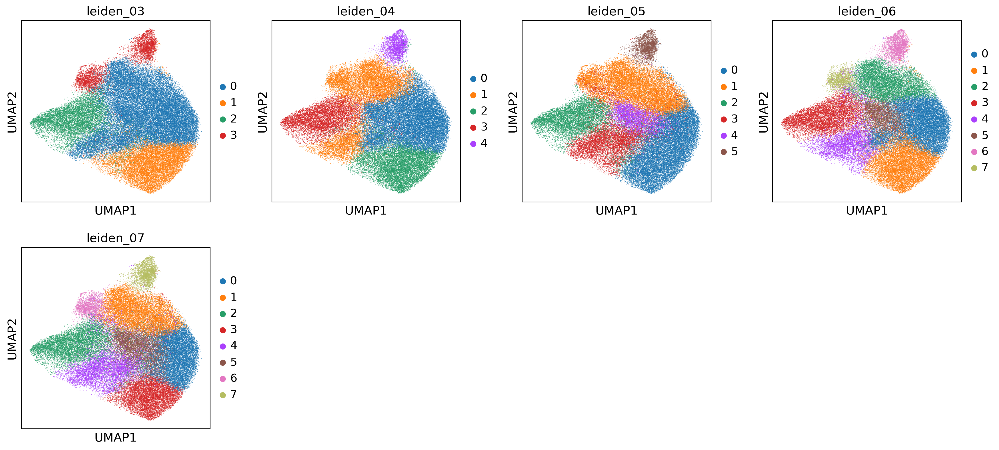

In [64]:
sc.pl.umap(FB_all_nobackground_harmony, 
           color=['leiden_03', 'leiden_04', 'leiden_05', 'leiden_06', 'leiden_07'], 
           projection='2d', components=['1,2'])

In our previous paper, the Fibroblast states have been also annotated. To confirm the overlap of this annotation with the previous version, we compare the assigned states with the previous clustering. For that we plot the cluster identities assigned on the uMAP. We can see good agreement between both clusterings, with  identification of new clusters (called vFB1.1 and vFB1.2). 

Trying to set attribute `.uns` of view, copying.


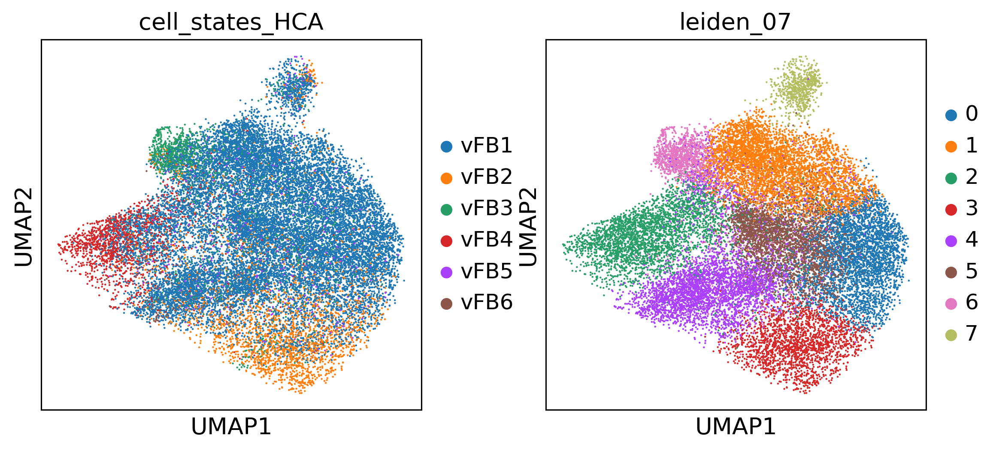

In [74]:
sc.pl.umap(FB_all_nobackground_harmony[~FB_all_nobackground_harmony.obs.cell_states_HCA.isin(['Not in HCA']) & 
                                      FB_all_nobackground_harmony.obs.cell_type_global_HCA.isin(['fb'])], 
           color=['cell_states_HCA', 'leiden_07'], 
           projection='2d', components=['1,2'])

As we can see there is high overlap between this and the previous clustering. Two additional states have been found, which might be related to the increase of 10x V3 (higher UMI coverage, sensitivity) or the inclusion of disease samples. 

We decided that leiden_07 gives the best results (best overlap with previous clustering). DE genes are calculated below

## Evaluation of clusters (compare leiden resolution 0.6)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:06:27)


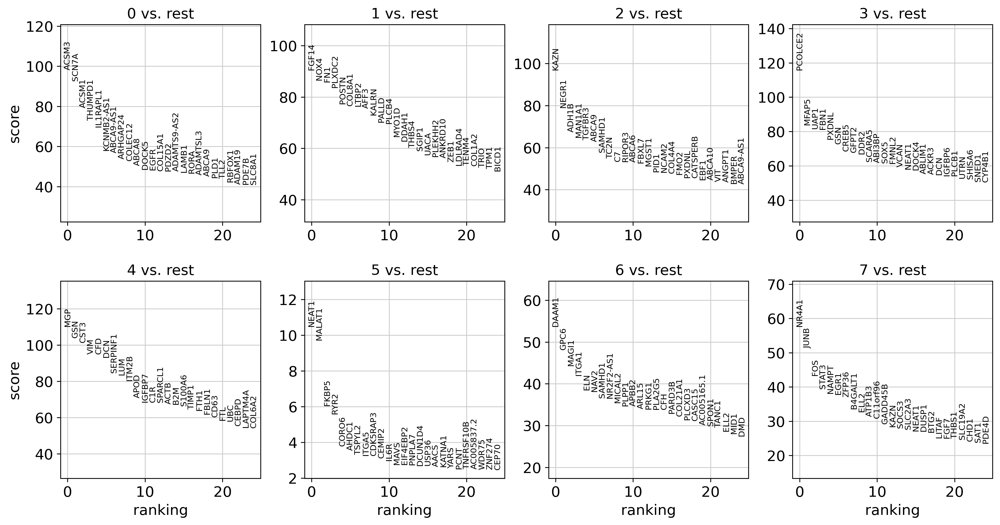

In [84]:
sc.tl.rank_genes_groups(FB_all_nobackground_harmony, 'leiden_06', method='wilcoxon')
sc.pl.rank_genes_groups(FB_all_nobackground_harmony, n_genes=25, sharey=False)

In [85]:
expression=filter_by_expression(FB_all_nobackground_harmony, 'leiden_06', key='rank_genes_groups')
expression.head(n=5)

,0_na,0_pv,0_lo,0_pi,0_po,0_ei,0_eo,1_na,1_pv,1_lo,...,6_po,6_ei,6_eo,7_na,7_pv,7_lo,7_pi,7_po,7_ei,7_eo
0,ACSM3,0.0,1.413973,0.886832,0.722174,3.136180,2.225898,FGF14,0.0,1.974624,...,0.368592,1.551349,0.692291,NR4A1,0.0,3.490336,0.526651,0.105327,1.308656,0.215401
1,SCN7A,0.0,1.059853,0.931615,0.815001,3.121508,2.433582,NOX4,0.0,1.528409,...,0.230831,1.421059,0.494236,JUNB,0.0,2.519943,0.553302,0.192788,1.300526,0.382352
2,ACSM1,0.0,1.338276,0.623034,0.395230,1.446126,0.825945,FN1,0.0,1.674426,...,0.213374,1.117798,0.392837,FOS,0.0,3.169926,0.404626,0.084034,0.987997,0.171696
3,THUMPD1,0.0,1.227865,0.602132,0.402865,1.374844,0.815985,PLXDC2,0.0,1.117662,...,0.174856,0.963750,0.311265,STAT3,0.0,1.459066,0.603587,0.375630,1.345722,0.709681
4,IL1RAPL1,0.0,1.135015,0.655543,0.464088,1.633291,1.056506,POSTN,0.0,4.512543,...,0.388354,1.535349,0.809399,NAMPT,0.0,2.654269,0.387026,0.111801,0.853913,0.194134


In [153]:
x_cntrl=FB_all_nobackground_harmony[FB_all_nobackground_harmony.obs.Gene.isin(['control'])].copy()
subset_=sc.AnnData(x_cntrl[:,x_cntrl.var.index].raw.X, # 
                  obs=x_cntrl.obs,
                  var=x_cntrl[:,x_cntrl.var.index].raw.var
                 )

subset_.raw=subset_

x=correlation_analysis(subset_, 'leiden_06', sum_or_mean="mean")
x=pd.DataFrame.from_dict(x)
x['leiden_06']=subset_.var.index
x=x.iloc[np.where(x.mean(axis=1)>0.1)[0],:]
x=x.iloc[np.where(x.mean(axis=1)<4)[0],:]

x.corr(method='pearson').style.background_gradient(cmap='coolwarm')

,0,1,2,3,4,5,6,7
0,1.000000,0.951042,0.978870,0.957695,0.939374,0.986702,0.966148,0.945301
1,0.951042,1.000000,0.922374,0.936374,0.908458,0.949738,0.953830,0.931921
2,0.978870,0.922374,1.000000,0.958313,0.925027,0.983109,0.968958,0.947347
3,0.957695,0.936374,0.958313,1.000000,0.939805,0.970921,0.947953,0.947393
4,0.939374,0.908458,0.925027,0.939805,1.000000,0.950357,0.914649,0.935544
5,0.986702,0.949738,0.983109,0.970921,0.950357,1.000000,0.971332,0.959625
6,0.966148,0.953830,0.968958,0.947953,0.914649,0.971332,1.000000,0.949952
7,0.945301,0.931921,0.947347,0.947393,0.935544,0.959625,0.949952,1.000000


/fast/AG_Huebner/GUIX_PROFILES/conda_envs/scanpy_151/lib/python3.8/site-packages/seaborn/axisgrid.py:100: UserWarning: The handle <matplotlib.patches.Patch object at 0x2b14f4e6fb80> has a label of '_nolegend_' which cannot be automatically added to the legend.
  figlegend = self.fig.legend(handles, labels, **kwargs)


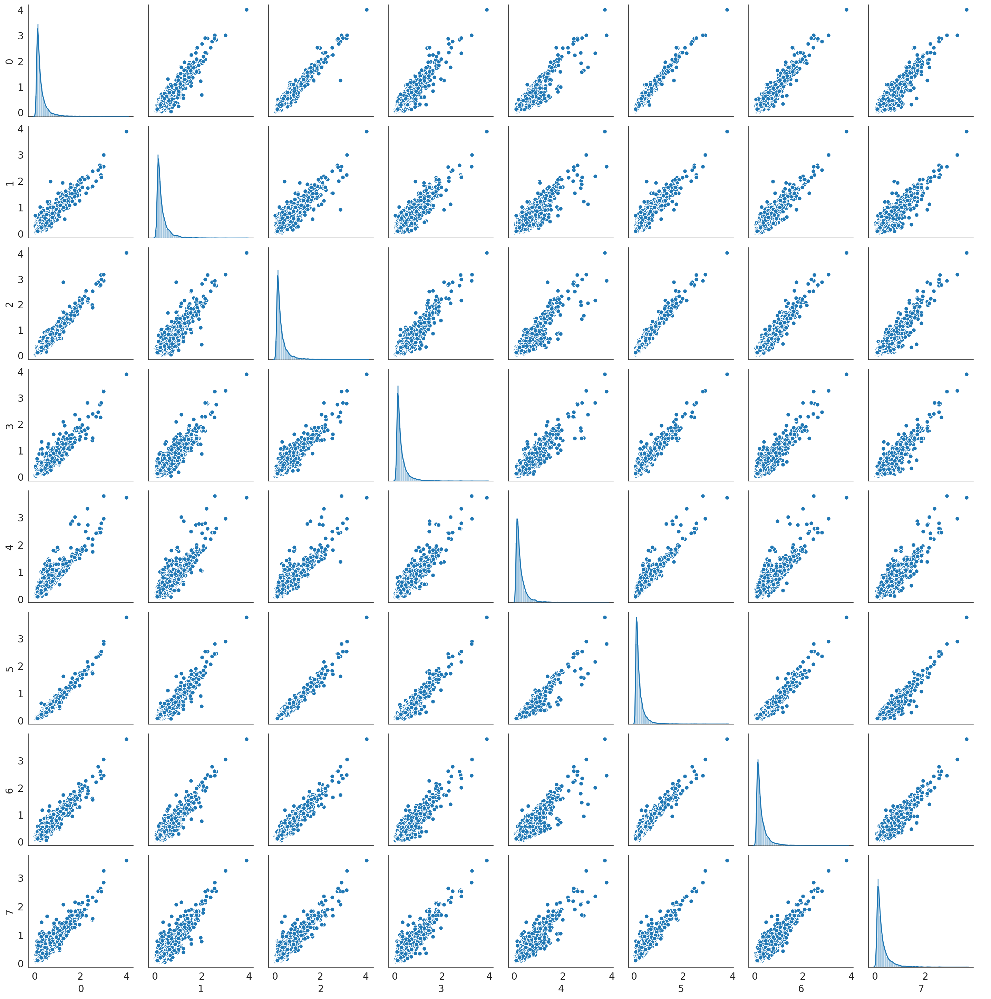

In [154]:
#fig, ax =plt.subplots(1,2)
#sns.scatterplot(x['1'], x['2'], ax=ax[0])
#plt.xlim(0,3)
#plt.ylim(0,3)
#plt.axline((0, 0), slope=.2, c=".2", ls="--", zorder=0)
#sns.scatterplot(x['0'], x['2'], ax=ax[1])
#plt.xlim(0,3)
#plt.ylim(0,3)
#fig.show()

g = sns.PairGrid(x.iloc[:,0:(x.shape[1]-1)])
g.map_diag(sns.distplot)
g.map_offdiag(sns.scatterplot)
g.add_legend()

-> We observe that Cluster 0, 2 and 5 show very high correlation and might only represent small trends of the same cell-state. This is why those 3 clusters are merged. 

Before merging the clusters, we plot the relative abundance of states per fibroblasts (100%). 

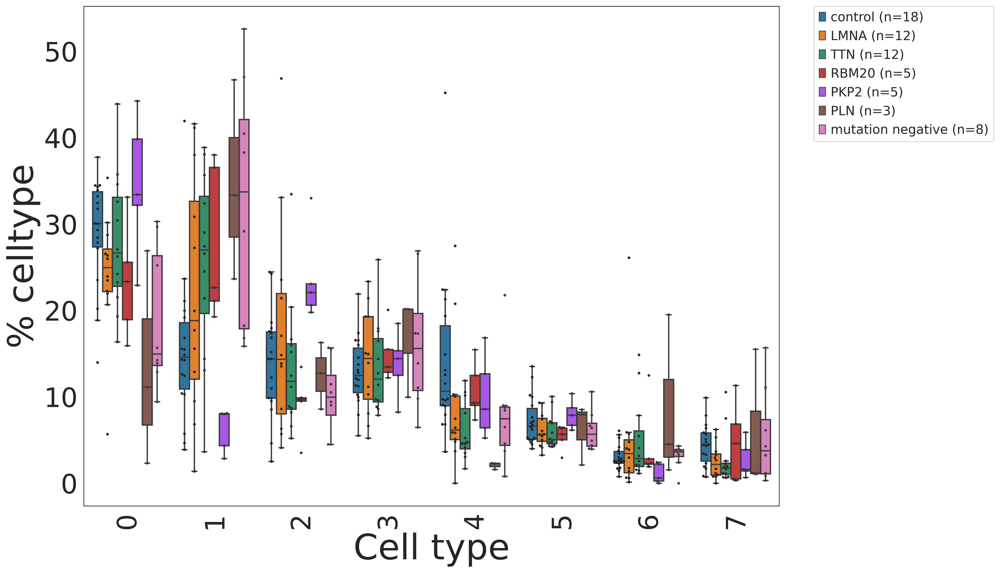

In [157]:
plot_celltype_abundance(FB_all_nobackground_harmony.obs, 'LV', variable='leiden_06', 
                            normalised_by=None, 
                            Genes_column='Gene',
                            Genes_to_plot=[ 'control', 'LMNA', 'TTN', 'RBM20', 'PKP2', 'PLN', 'mutation negative'], 
                            celltypes_to_plot=['0', '1', '2', '3', '4', '5', '6', '7'], plottype="boxplot", 
                            show_points=True, return_table=False, save_png=None, ylimit=None)

## Are subclusters distinct - merging subtypes?

AUCs calculated by SCCAF - controls only

Mean CV accuracy: 0.5524
Accuracy on the training set: 1.0000
Accuracy on the hold-out set: 0.5383


<Figure size 1960x1400 with 0 Axes>

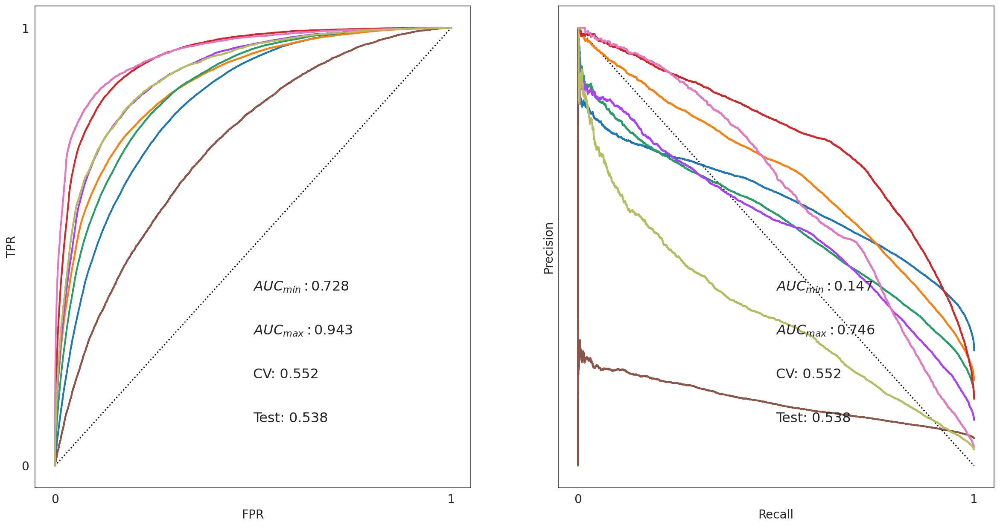

In [158]:
plt.rcParams['figure.figsize'] = [20, 10]
plt.figure(figsize=[14,10], dpi=140, facecolor='w', edgecolor='k')
y_prob, y_pred, y_test, clf, cvsm, acc = SCCAF_assessment(FB_all_nobackground_harmony.raw.X, 
                                                          FB_all_nobackground_harmony.obs['leiden_06'],n=1000)
aucs = plot_roc(y_prob, y_test, clf, cvsm=cvsm, acc=acc)
plt.show()

Clusters 0,2 and 5 show very high correlation, which is why we decided to merge them

In [159]:
FB_all_nobackground_harmony.obs['cell_states']=FB_all_nobackground_harmony.obs['leiden_06']
subs = {
    "0":"vFB1.0",
    "1":"vFB2", # 
    "2":"vFB1.0",
    "3":"vFB4",
    "4":"vFB1.1", # 
    "5":"vFB1.0",
    "6":"vFB1.2",
    "7":"vFB3",
     } 
# PC-like, EC-like, MP-like, MP_interacting, CM-like, ECM_r, CST3+, ECM_p, Canonical, DAAM1+
x=[subs.get(item,item)  for item in FB_all_nobackground_harmony.obs['cell_states']]
FB_all_nobackground_harmony.obs['cell_states']=x
pd.value_counts(FB_all_nobackground_harmony.obs['cell_states'])/FB_all_nobackground_harmony.shape[0]

vFB1.0    0.473742
vFB2      0.191120
vFB4      0.144382
vFB1.1    0.102804
vFB1.2    0.046178
vFB3      0.041774
Name: cell_states, dtype: float64

Mean CV accuracy: 0.6597
Accuracy on the training set: 1.0000
Accuracy on the hold-out set: 0.6018


<Figure size 1960x1400 with 0 Axes>

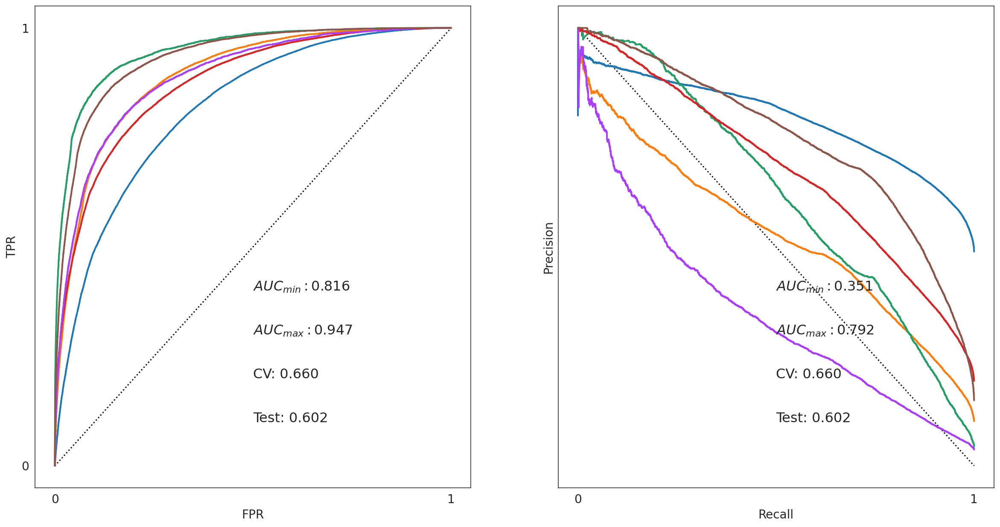

In [160]:
plt.rcParams['figure.figsize'] = [20, 10]
plt.figure(figsize=[14,10], dpi=140, facecolor='w', edgecolor='k')
y_prob, y_pred, y_test, clf, cvsm, acc = SCCAF_assessment(FB_all_nobackground_harmony.raw.X, 
                                                          FB_all_nobackground_harmony.obs['cell_states'],n=1000)
aucs = plot_roc(y_prob, y_test, clf, cvsm=cvsm, acc=acc)
plt.show()

-> SCCAF shows higher accuracy with the merged annotation, this is why we procede with this! However, maybe the SCN7A and KAZN cluster will show up as distinct populations in the future. But too few genes discriminate them (see dotplot)

In [165]:
FB_all_nobackground_harmony.write(path_in + "/FB_nodoublets_ANNOTATED.h5ad")
FB_all_nobackground_harmony.obs.to_csv(path_in + "/FB_nodoublets_LEIDEN_OBS.csv")

... storing 'cell_states' as categorical


Trying to set attribute `.uns` of view, copying.


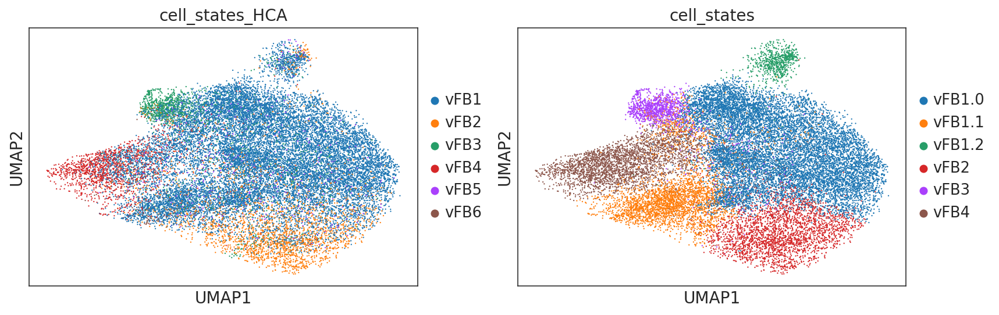

In [167]:
sc.pl.umap(FB_all_nobackground_harmony[~FB_all_nobackground_harmony.obs.cell_states_HCA.isin(['Not in HCA']) & 
                                      FB_all_nobackground_harmony.obs.cell_type_global_HCA.isin(['fb'])], 
           color=['cell_states_HCA', 'cell_states'], 
           projection='2d', components=['1,2'])